In [1]:
# scientific computing libaries
import pandas as pd
import numpy as np

# data mining libaries
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import RFECV, VarianceThreshold
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA#, FastICA
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, GridSearchCV, learning_curve
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer, accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from ml_metrics import quadratic_weighted_kappa
random_state = 42
from sklearn.metrics import roc_curve, auc, confusion_matrix, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import make_pipeline, Pipeline
from imblearn.over_sampling import SMOTE

#plot libaries
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style(style='darkgrid')
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True) # to show plots in notebook

# online plotly
#from plotly.plotly import plot, iplot
#plotly.tools.set_credentials_file(username='XXXXXXXXXXXXXXX', api_key='XXXXXXXXXXXXXXX')

# offline plotly
from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

SEED = 2020 # specify seed for reproducable results
pd.set_option('display.max_columns', None) # prevents abbreviation (with '...') of columns in prints

In [2]:
core = pd.read_csv("All_data.txt",sep='\t')
core.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [3]:
core = core.drop_duplicates(subset='ID', keep="first")

In [4]:
core = core.drop(['Sorghum_v3_1_annotation', 'Tzi8'], axis = 1)

In [5]:
cat_col = ['ID','classical_label','core_label','Origin','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type','chromosome']
for col in core.columns:
    if col not in cat_col and core[col].dtypes == 'object':
        core[col] = core[col].replace('None', np.nan)
        core[col] = core[col].replace('none', np.nan)
        core[col] = core[col].replace('NA16', np.nan)
        core[col] = core[col].replace('#VALUE!', np.nan)
        core[col] = core[col].astype(float)
core.dtypes

ID                                        object
classical_label                           object
Origin                                    object
core_label                                object
DCC_Twist_Tilt_lag_1                     float64
                                          ...   
variants_effect_stop_gained              float64
variants_effect_stop_lost                float64
variants_effect_stop_retained_variant    float64
variants_effect_synonymous_variant       float64
variants_effect_upstream_gene_variant    float64
Length: 14294, dtype: object

In [6]:
Extra_test = core[core['core_label'] == 'None']
Extra_test.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [7]:
core = core[core['core_label'] != 'None']
core.shape

(38882, 14294)

In [8]:
for ele in core['core_label']:
    if ele != 'Core Gene':
        core['core_label'] = core['core_label'].replace(ele,'Non-Core Gene')
core.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [9]:
classes=core['core_label'].value_counts()
Gene_NonCore=round(classes['Non-Core Gene']/core['core_label'].count()*100,2)
Gene_Core=round(classes['Core Gene']/core['core_label'].count()*100, 2)
print("Non-Core : {} %".format(Gene_NonCore))
print("    Core : {} %".format(Gene_Core))

Non-Core : 27.63 %
    Core : 72.37 %


In [10]:
for col in cat_col:
    core[col] = core[col].replace('None', "Unknown")
    print(col,core[col].isnull().sum())

ID 0
classical_label 0
core_label 0
Origin 0
Subcel1 0
Subcel2 0
Subcel3 0
Subcel4 0
Subcel5 0
Localization 0
Type 0
chromosome 0


In [11]:
core['classical_label'] = core['classical_label'].replace("Unknown",'Others')
core['classical_label'] = core['classical_label'].replace("1",'Classical')

In [12]:
num_col = [ele for ele in core.columns if ele not in cat_col]
len(num_col)

14282

In [13]:
core_mis = core
del core
# core_mis = core_mis.fillna(0)
core_mis.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [14]:
classical_label = pd.get_dummies(core_mis['classical_label'], prefix= 'class')
Origin = pd.get_dummies(core_mis['Origin'], prefix= 'Origin')
Subcel1 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel1')
Subcel2 = pd.get_dummies(core_mis['Subcel2'], drop_first=True, prefix= 'Subcel2')
Subcel3 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel3')
Subcel4 = pd.get_dummies(core_mis['Subcel2'], drop_first=True, prefix= 'Subcel4')
Subcel5 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel5')
Localization = pd.get_dummies(core_mis['Localization'], drop_first=True, prefix= 'Localization')
Type = pd.get_dummies(core_mis['Type'], drop_first=True, prefix= 'Type')
chromosome = pd.get_dummies(core_mis['chromosome'], drop_first=True, prefix= 'chrom')

core_2 = pd.concat([core_mis,classical_label,Origin,Subcel1,Subcel2,Subcel3,Subcel4,Subcel5,Localization,Type,chromosome],axis=1)

core_2 = core_2.drop(['ID','classical_label','Origin','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type','chromosome'],1)

In [15]:
core_2['core_label'] = core_2['core_label'].replace('Non-Core Gene',0)
core_2['core_label'] = core_2['core_label'].replace('Core Gene',1)

In [16]:
del core_mis
core_2.head()

,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF_35,1kb_ARF_36,1kb_ARF_39,

In [18]:
seq_fea = pd.read_csv("seq_features_final.txt",sep='\t',header=None)
core_seq = core_2[list(seq_fea[0])]
core_seq.head()

,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Exon_quad,Flanking_quad,Intergenic_quad,Intron_Quad,UTR_Quad,CTDC_hydrophobicity_Group1,CTDC_hydrophobicity_Group2,CTDC_hydrophobicity_Group3,CTDC_normwaalsvolume_Group1,CTDC_normwaalsvolume_Group2,CTDC_normwaalsvolume_Group3,CTDC_polarity_Group1,CTDC_polarity_Group2,CTDC_polarity_Group3,CTDC_polarizability_Group1,CTDC_polarizability_Group2,CTDC_polarizability_Group3,CTDC_charge_Group1,CTDC_charge_Group2,CTDC_charge_Group3,CTDC_secondarystruct_Group1,CTDC_secondarystruct_Group2,CTDC_secondarystruct_Group3,CTDC_solventaccess_Group1,CTDC_solventaccess_Group2,CTDC_solventaccess_Group3,CTDT_prop1_Tr1221,CTDT_prop1_Tr1331,CTDT_prop1_Tr2332,CTDT_prop2_Tr1221,CTDT_prop2_Tr1331,CTDT_prop2_Tr2332,CTDT_prop3_Tr1221,CTDT_prop3_Tr1331,CTDT_prop3_Tr2332,CTDT_prop4_Tr1221,CTDT_prop4_Tr1331,CTDT_prop4_Tr2332

In [19]:
core_seq.shape

(38882, 10272)

In [20]:
cat_col = ['core_label','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type']
new_cat_col = []
for col in core_seq.columns:
    if col.startswith('Subcel') or col.startswith('Localization') or col.startswith('Type') or col.startswith('core_label'):
        new_cat_col.append(col)      
# new_cat_col

In [21]:
# cat_col = ['core_label','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type']
num_col = [ele for ele in core_seq.columns if ele not in new_cat_col]
len(num_col)

10161

In [22]:
X = core_seq.drop('core_label', axis=1)  
y = core_seq['core_label'] 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 2020, stratify=y)

In [23]:
X_train = X_train.dropna(axis=1, thresh=0.8) #drop the columns with missing rate > 80%
print(X_train.shape)

(31105, 10271)


In [24]:
X_test = X_test.dropna(axis=1, thresh=0.8) #drop the columns with missing rate > 80%
print(X_test.shape)

(7777, 10271)


In [25]:
X_train = X_train.fillna(0)
ss = StandardScaler()
# num_col.remove('L4_preligule')
# num_col.remove('lg1_3_lg1_R_mutant')
X_train[num_col] = ss.fit_transform(X_train[num_col])

In [26]:
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_train, y_train)

In [27]:
print(X_res.shape)

(45020, 10271)


In [49]:
# Threshold for removing correlated variables
threshold = 0.8

# Absolute value correlation matrix
corr_matrix = X_res.corr().abs()
corr_matrix.head()

,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Exon_quad,Flanking_quad,Intergenic_quad,Intron_Quad,UTR_Quad,CTDC_hydrophobicity_Group1,CTDC_hydrophobicity_Group2,CTDC_hydrophobicity_Group3,CTDC_normwaalsvolume_Group1,CTDC_normwaalsvolume_Group2,CTDC_normwaalsvolume_Group3,CTDC_polarity_Group1,CTDC_polarity_Group2,CTDC_polarity_Group3,CTDC_polarizability_Group1,CTDC_polarizability_Group2,CTDC_polarizability_Group3,CTDC_charge_Group1,CTDC_charge_Group2,CTDC_charge_Group3,CTDC_secondarystruct_Group1,CTDC_secondarystruct_Group2,CTDC_secondarystruct_Group3,CTDC_solventaccess_Group1,CTDC_solventaccess_Group2,CTDC_solventaccess_Group3,CTDT_prop1_Tr1221,CTDT_prop1_Tr1331,CTDT_prop1_Tr2332,CTDT_prop2_Tr1221,CTDT_prop2_Tr1331,CTDT_prop2_Tr2332,CTDT_prop3_Tr1221,CTDT_prop3_Tr1331,CTDT_prop3_Tr2332,CTDT_prop4_Tr1221,CTDT_prop4_Tr1331,CTDT_prop4_Tr2332,CTDT_prop5

In [50]:
# Upper triangle of correlations
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper.head()

,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Exon_quad,Flanking_quad,Intergenic_quad,Intron_Quad,UTR_Quad,CTDC_hydrophobicity_Group1,CTDC_hydrophobicity_Group2,CTDC_hydrophobicity_Group3,CTDC_normwaalsvolume_Group1,CTDC_normwaalsvolume_Group2,CTDC_normwaalsvolume_Group3,CTDC_polarity_Group1,CTDC_polarity_Group2,CTDC_polarity_Group3,CTDC_polarizability_Group1,CTDC_polarizability_Group2,CTDC_polarizability_Group3,CTDC_charge_Group1,CTDC_charge_Group2,CTDC_charge_Group3,CTDC_secondarystruct_Group1,CTDC_secondarystruct_Group2,CTDC_secondarystruct_Group3,CTDC_solventaccess_Group1,CTDC_solventaccess_Group2,CTDC_solventaccess_Group3,CTDT_prop1_Tr1221,CTDT_prop1_Tr1331,CTDT_prop1_Tr2332,CTDT_prop2_Tr1221,CTDT_prop2_Tr1331,CTDT_prop2_Tr2332,CTDT_prop3_Tr1221,CTDT_prop3_Tr1331,CTDT_prop3_Tr2332,CTDT_prop4_Tr1221,CTDT_prop4_Tr1331,CTDT_prop4_Tr2332,CTDT_prop5

In [51]:
# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))

There are 863 columns to remove.


In [52]:
train = X_res.drop(columns = to_drop)
print('Training shape: ', train.shape)

Training shape:  (45020, 9408)


In [53]:
param = {'C': [10**-2,10**-1,10**0,10**1,10**2]}
lr_model = LogisticRegression(penalty='l1', solver='saga',random_state=random_state)
gs_model = GridSearchCV(estimator=lr_model,param_grid=param)
gs_model.fit(train,y_res)

GridSearchCV(estimator=LogisticRegression(penalty='l1', random_state=42,
                                          solver='saga'),
             param_grid={'C': [0.01, 0.1, 1, 10, 100]})

In [54]:
gs_model.best_params_

{'C': 0.1}

In [74]:
import itertools
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(10,10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

========== LogisticRegression ==========
Accuracy in training: 0.9396657041314971
Accuracy in valid: 0.8539537983118614
TP:3783, TN:3906, FP:596, FN:719


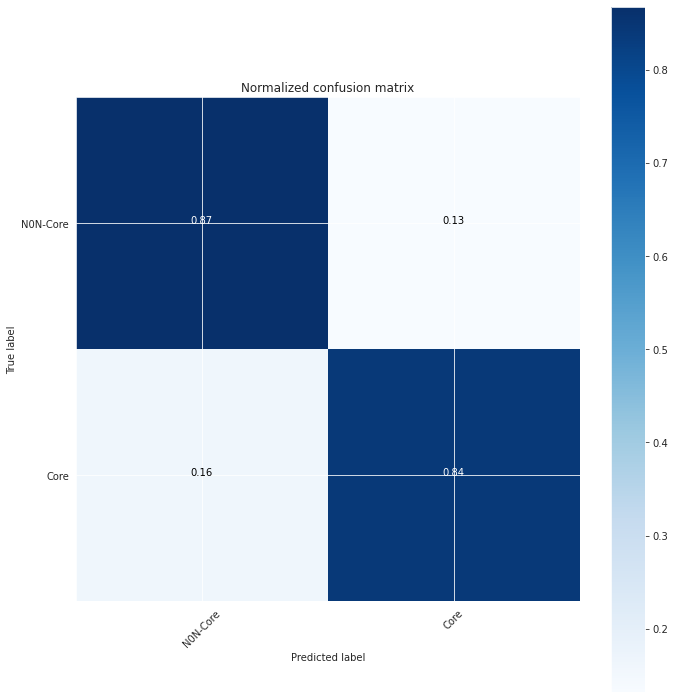

Show top 10 important features:


,feature_importance,ranking
UTR3length,0.550622,1.0
isoforms,0.514898,2.0
Subcel1_chlo,0.463196,3.0
Subcel1_nucl,0.450775,4.0
Localization_Cytoplasm,0.406735,5.0
Subcel2_chlo,0.379350,6.0
Subcel2_none,0.364557,7.0
Localization_Nucleus,0.362907,8.0
Subcel1_cyto,0.359457,9.0
Subcel2_cyto,0.348141,10.0


========== ExtraTreesClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.904042647712128
TP:4226, TN:3914, FP:588, FN:276


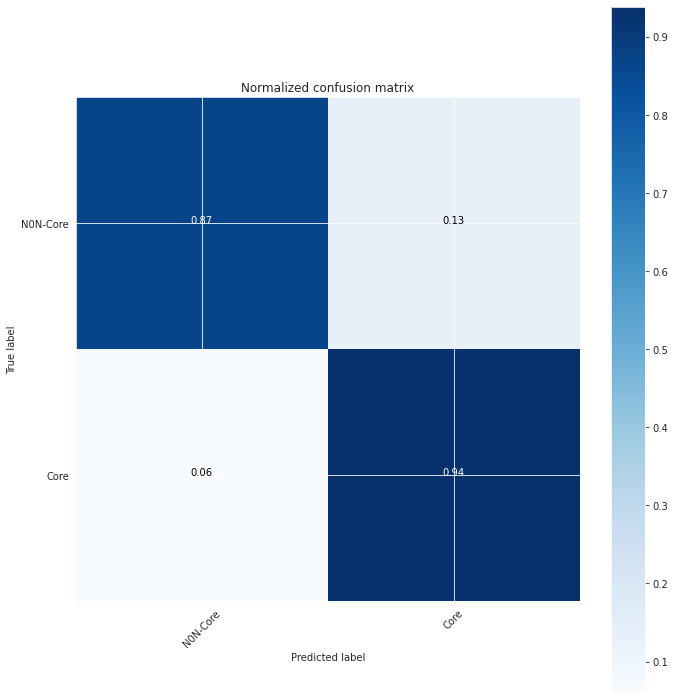

Show top 10 important features:


,feature_importance,ranking
UTR3length,0.004103,1.0
Subcel2_none,0.003591,2.0
CTriad_VS111,0.003528,3.0
isoforms,0.003141,4.0
Subcel1_plas,0.002592,5.0
Subcel1_nucl,0.002550,6.0
CTDD_prop5_G2_residue0,0.002288,7.0
Subcel2_cyto,0.001838,8.0
UTR5length,0.001814,9.0
Subcel2_chlo,0.001651,10.0


========== RandomForestClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.8938249666814749
TP:4157, TN:3891, FP:611, FN:345


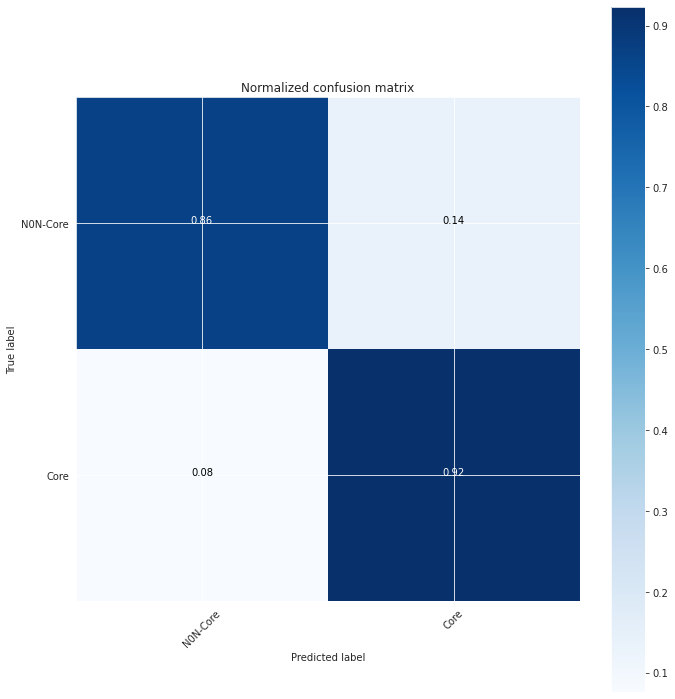

Show top 10 important features:


,feature_importance,ranking
UTR3length,0.018194,1.0
UTR5length,0.011481,2.0
isoforms,0.009625,3.0
CTDD_prop7_G3_residue0,0.006320,4.0
CTDD_prop1_G2_residue0,0.006050,5.0
CTDD_prop2_G3_residue0,0.005105,6.0
CTDD_prop1_G3_residue0,0.004832,7.0
CTDD_prop5_G2_residue0,0.004128,8.0
CTriad_VS111,0.003618,9.0
avgExonLength,0.002932,10.0


========== GradientBoostingClassifier ==========
Accuracy in training: 0.8915482007996446
Accuracy in valid: 0.8864948911594847
TP:4105, TN:3877, FP:625, FN:397


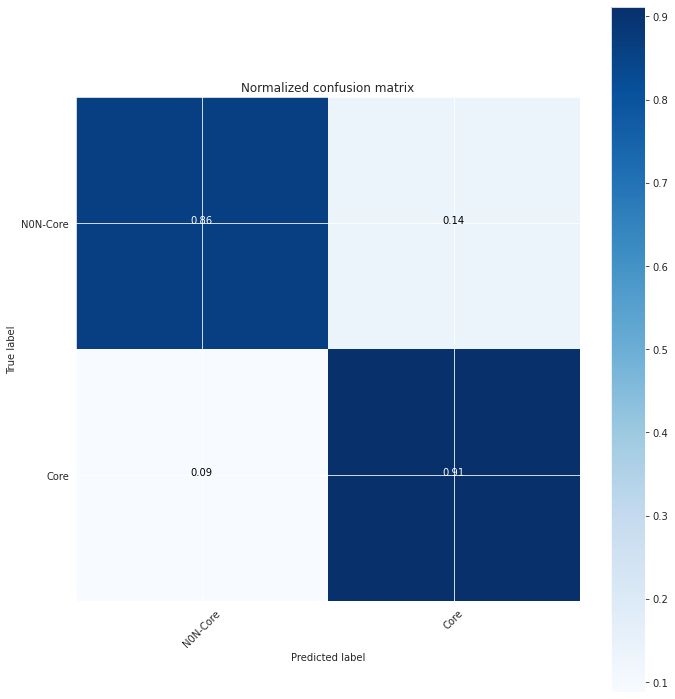

Show top 10 important features:


,feature_importance,ranking
UTR3length,0.248696,1.0
isoforms,0.110741,2.0
TC_LPL,0.037803,3.0
TC_DSL,0.034374,4.0
PseKNC_3_Xc1_TAG,0.029627,5.0
PseKNC_3_Xc1_ACG,0.027717,6.0
TC_SAL,0.026195,7.0
TC_VVA,0.025302,8.0
TC_RSA,0.024271,9.0
CTriad_VS111,0.022984,10.0


In [75]:
from sklearn.ensemble import GradientBoostingClassifier
X_model, X_valid, y_model, y_valid = train_test_split(train, y_res, stratify=y_res, random_state=random_state, test_size=.2)

model_dict = {'LogisticRegression': LogisticRegression(C=0.1,penalty='l1',solver='saga',random_state=random_state)
             , 'ExtraTreesClassifier': ExtraTreesClassifier(n_estimators=200, n_jobs=-1, random_state=random_state)
              , 'RandomForestClassifier': RandomForestClassifier(random_state=random_state, n_jobs=-1)
              , 'GradientBoostingClassifier' : GradientBoostingClassifier(random_state=random_state)
             }
estimator_dict = {}
importance_fatures_sorted_all = pd.DataFrame()
for model_name, model in model_dict.items():
    print('='*10, model_name, '='*10)
    model.fit(X_model, y_model)
    print('Accuracy in training:', accuracy_score(model.predict(X_model), y_model))
    print('Accuracy in valid:', accuracy_score(model.predict(X_valid), y_valid))
    LR_ypred = model.predict(X_valid)
    LR_cnf_matrix = confusion_matrix(y_valid, LR_ypred)
    print("TP:{}, TN:{}, FP:{}, FN:{}".format(LR_cnf_matrix[1][1], LR_cnf_matrix[0][0], LR_cnf_matrix[0][1], LR_cnf_matrix[1][0]))
    np.set_printoptions(precision=2)
    plot_confusion_matrix(LR_cnf_matrix, classes=["N0N-Core","Core"], title='Normalized confusion matrix')
    importance_values = np.absolute(model.coef_) if model_name == 'LogisticRegression' else model.feature_importances_
    importance_fatures_sorted = pd.DataFrame(importance_values.reshape([-1, len(train.columns)]), columns=train.columns).mean(axis=0).sort_values(ascending=False).to_frame()
    importance_fatures_sorted.rename(columns={0: 'feature_importance'}, inplace=True)
    importance_fatures_sorted['ranking']= importance_fatures_sorted['feature_importance'].rank(ascending=False)
    importance_fatures_sorted['model'] = model_name
    print('Show top 10 important features:')
    display(importance_fatures_sorted.drop('model', axis=1).head(50))
    importance_fatures_sorted_all = importance_fatures_sorted_all.append(importance_fatures_sorted)
    estimator_dict[model_name] = model

In [55]:
from sklearn.ensemble import GradientBoostingClassifier
X_model, X_valid, y_model, y_valid = train_test_split(train, y_res, stratify=y_res, random_state=random_state, test_size=.2)

model_dict = {'LogisticRegression': LogisticRegression(C=0.1,penalty='l1',solver='saga',random_state=random_state)
             , 'ExtraTreesClassifier': ExtraTreesClassifier(n_estimators=200, n_jobs=-1, random_state=random_state)
              , 'RandomForestClassifier': RandomForestClassifier(random_state=random_state, n_jobs=-1)
              , 'GradientBoostingClassifier' : GradientBoostingClassifier(random_state=random_state)
             }
estimator_dict = {}
importance_fatures_sorted_all = pd.DataFrame()
for model_name, model in model_dict.items():
    print('='*10, model_name, '='*10)
    model.fit(X_model, y_model)
    print('Accuracy in training:', accuracy_score(model.predict(X_model), y_model))
    print('Accuracy in valid:', accuracy_score(model.predict(X_valid), y_valid))
    LR_ypred = model.predict(X_valid)
    LR_cnf_matrix = confusion_matrix(y_valid, LR_ypred)
    print("TP:{}, TN:{}, FP:{}, FN:{}".format(LR_cnf_matrix[1][1], LR_cnf_matrix[0][0], LR_cnf_matrix[0][1], LR_cnf_matrix[1][0]))
    np.set_printoptions(precision=2)
    plot_confusion_matrix(LR_cnf_matrix, classes=["N0N-Core","Core"], title='Normalized confusion matrix')
    importance_values = np.absolute(model.coef_) if model_name == 'LogisticRegression' else model.feature_importances_
    importance_fatures_sorted = pd.DataFrame(importance_values.reshape([-1, len(train.columns)]), columns=train.columns).mean(axis=0).sort_values(ascending=False).to_frame()
    importance_fatures_sorted.rename(columns={0: 'feature_importance'}, inplace=True)
    importance_fatures_sorted['ranking']= importance_fatures_sorted['feature_importance'].rank(ascending=False)
    importance_fatures_sorted['model'] = model_name
    print('Show top 10 important features:')
    display(importance_fatures_sorted.drop('model', axis=1).head(50))
    importance_fatures_sorted_all = importance_fatures_sorted_all.append(importance_fatures_sorted)
    estimator_dict[model_name] = model

========== LogisticRegression ==========
Accuracy in training: 0.9396657041314971
Accuracy in valid: 0.8539537983118614
Show top 10 important features:


,feature_importance,ranking
UTR3length,0.550622,1.0
isoforms,0.514898,2.0
Subcel1_chlo,0.463196,3.0
Subcel1_nucl,0.450775,4.0
Localization_Cytoplasm,0.406735,5.0
Subcel2_chlo,0.379350,6.0
Subcel2_none,0.364557,7.0
Localization_Nucleus,0.362907,8.0
Subcel1_cyto,0.359457,9.0
Subcel2_cyto,0.348141,10.0


========== ExtraTreesClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.904042647712128
Show top 10 important features:


,feature_importance,ranking
UTR3length,0.004103,1.0
Subcel2_none,0.003591,2.0
CTriad_VS111,0.003528,3.0
isoforms,0.003141,4.0
Subcel1_plas,0.002592,5.0
Subcel1_nucl,0.002550,6.0
CTDD_prop5_G2_residue0,0.002288,7.0
Subcel2_cyto,0.001838,8.0
UTR5length,0.001814,9.0
Subcel2_chlo,0.001651,10.0


========== RandomForestClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.8938249666814749
Show top 10 important features:


,feature_importance,ranking
UTR3length,0.018194,1.0
UTR5length,0.011481,2.0
isoforms,0.009625,3.0
CTDD_prop7_G3_residue0,0.006320,4.0
CTDD_prop1_G2_residue0,0.006050,5.0
CTDD_prop2_G3_residue0,0.005105,6.0
CTDD_prop1_G3_residue0,0.004832,7.0
CTDD_prop5_G2_residue0,0.004128,8.0
CTriad_VS111,0.003618,9.0
avgExonLength,0.002932,10.0


========== GradientBoostingClassifier ==========
Accuracy in training: 0.8915482007996446
Accuracy in valid: 0.8864948911594847
Show top 10 important features:


,feature_importance,ranking
UTR3length,0.248696,1.0
isoforms,0.110741,2.0
TC_LPL,0.037803,3.0
TC_DSL,0.034374,4.0
PseKNC_3_Xc1_TAG,0.029627,5.0
PseKNC_3_Xc1_ACG,0.027717,6.0
TC_SAL,0.026195,7.0
TC_VVA,0.025302,8.0
TC_RSA,0.024271,9.0
CTriad_VS111,0.022984,10.0


In [60]:
importance_fatures_sorted_all = importance_fatures_sorted_all.loc[:,~importance_fatures_sorted_all.columns.duplicated()]

In [61]:
importance_fatures_sorted_all.head()

,feature_importance,ranking,model
UTR3length,0.550622,1.0,LogisticRegression
isoforms,0.514898,2.0,LogisticRegression
Subcel1_chlo,0.463196,3.0,LogisticRegression
Subcel1_nucl,0.450775,4.0,LogisticRegression
Localization_Cytoplasm,0.406735,5.0,LogisticRegression


Text(0.5, 0, 'Number of features selected')

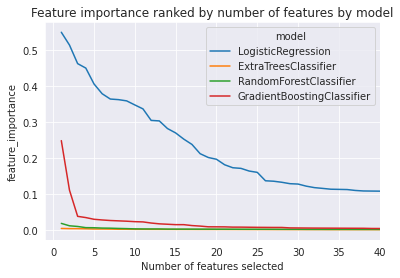

In [62]:
features_df = importance_fatures_sorted_all.copy()
features_df.reset_index(drop=True, inplace=True)
plt.title('Feature importance ranked by number of features by model')
sns.lineplot(x=features_df['ranking'], y=features_df['feature_importance'], hue=features_df['model'])
plt.xlim(-1,40)
plt.xlabel("Number of features selected")

In [63]:
selected_model = 'GradientBoostingClassifier'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

CPU times: user 1min 59s, sys: 6.26 s, total: 2min 5s
Wall time: 7min 20s


<function matplotlib.pyplot.show(close=None, block=None)>

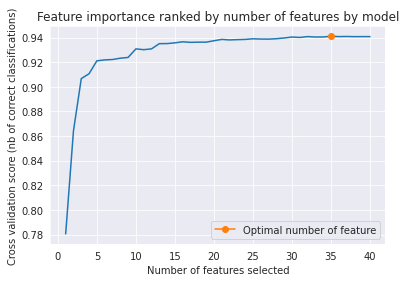

In [64]:
%%time
#it takes much more time comparing to the feature selelction by model
rfecv = RFECV(estimator=model_dict['GradientBoostingClassifier'], step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)
rfecv.fit(train[selected_features_by_model], y_res)
plt.figure()
plt.title('Feature importance ranked by number of features by model')
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.plot(rfecv.n_features_, rfecv.grid_scores_[rfecv.n_features_-1], marker='o', label='Optimal number of feature')
plt.legend(loc='best')
plt.show

In [65]:
selected_model = 'LogisticRegression'
number_of_features = 25
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()
# Init/fit
rfecv = RFECV(
    estimator=LogisticRegression(C=0.1,penalty='l1',solver='saga',random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
lasso_mask = rfecv.support_
lasso_mask
lasso_fea = train[selected_features_by_model]
lasso_fea = lasso_fea[lasso_fea.columns[lasso_mask]]
# rfecv.estimator_.coef_
lasso_fea.columns

Index(['UTR3length', 'isoforms', 'Subcel1_chlo', 'Subcel1_nucl',
       'Localization_Cytoplasm', 'Subcel2_chlo', 'Subcel2_none',
       'Localization_Nucleus', 'Subcel1_cyto', 'Subcel2_cyto', 'Subcel2_mito',
       'Type_Soluble', 'Subcel2_nucl', 'Localization_Plastid',
       'Localization_Mitochondrion', 'Subcel1_plas', 'UTR5length',
       'PAAC_Xc1_A', 'Subcel1_mito', 'Localization_Extracellular',
       'PseKNC_3_Xc1_TGT', 'Subcel2_vacu', 'CTDD_prop2_G3_residue0',
       'distance'],
      dtype='object')

In [66]:
selected_model = 'ExtraTreesClassifier'
number_of_features = 25
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()
rfecv = RFECV(
    estimator=ExtraTreesClassifier(n_estimators=200, n_jobs=-1, random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
ExtraTree_mask = rfecv.support_
ExtraTree_mask
ExtraTree_fea = train[selected_features_by_model]
ExtraTree_fea = ExtraTree_fea[ExtraTree_fea.columns[ExtraTree_mask]]

ExtraTree_fea.columns

Index(['UTR3length', 'CTriad_VS111', 'isoforms', 'CTDD_prop5_G2_residue0',
       'UTR5length', 'PseKNC_3_Xc1_TAG', 'PseDNC_Xc1_AT',
       'CTDD_prop1_G2_residue0', 'QSO_Grantham_Xd_1', 'QSO_Schneider_Xd_28',
       'avgExonLength'],
      dtype='object')

In [67]:
selected_model = 'RandomForestClassifier'
number_of_features = 25
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

rfecv = RFECV(
    estimator=RandomForestClassifier(random_state=random_state,n_jobs=-1), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
rf_mask = rfecv.support_
rf_mask
rf_fea = train[selected_features_by_model]
rf_fea = rf_fea[rf_fea.columns[rf_mask]]

rf_fea.columns

Index(['UTR3length', 'UTR5length', 'isoforms', 'CTDD_prop7_G3_residue0',
       'CTDD_prop1_G2_residue0', 'CTDD_prop2_G3_residue0',
       'CTDD_prop1_G3_residue0', 'CTDD_prop5_G2_residue0', 'CTriad_VS111',
       'avgExonLength', 'PseDNC_Xc1_GG', 'CTDD_prop7_G1_residue0',
       'CTDD_prop1_G1_residue0', 'CTDD_prop6_G3_residue0', 'PseKNC_3_Xc1_ACG',
       'TC_RAS', 'mRNAlength', 'QSO_Schneider_Xd_28', 'PAAC_Xc1_P',
       'PAAC_Xc1_A', 'PseDNC_Xc1_AT', 'QSO_Grantham_Xd_1', 'TC_LPL',
       'PseKNC_3_Xc1_TAG', 'TC_PAP'],
      dtype='object')

In [68]:
selected_model = 'GradientBoostingClassifier'
number_of_features = 25
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

rfecv = RFECV(
    estimator=GradientBoostingClassifier(random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
gb_mask = rfecv.support_
gb_mask
gb_fea = train[selected_features_by_model]
gb_fea = gb_fea[gb_fea.columns[gb_mask]]

gb_fea.columns

Index(['UTR3length', 'isoforms', 'TC_LPL', 'TC_DSL', 'PseKNC_3_Xc1_TAG',
       'PseKNC_3_Xc1_ACG', 'TC_SAL', 'TC_VVA', 'TC_RSA', 'CTriad_VS111',
       'CTDD_prop2_G3_residue0', 'Flanking_quad', 'distance',
       'CTDD_prop1_G2_residue0', 'TC_RAS', 'TC_ARG', 'TC_TKI', 'TC_RSS',
       'TC_IAK', 'TC_PAP'],
      dtype='object')

In [69]:
set(gb_fea.columns) & set(rf_fea.columns) & set(ExtraTree_fea.columns) & set(lasso_fea.columns)

{'UTR3length', 'isoforms'}

In [70]:
feature_list = list(set(gb_fea.columns) & set(rf_fea.columns) & set(ExtraTree_fea.columns) & set(lasso_fea.columns))
with open('seq_feature_file.txt', 'w') as out_f:
    for l in feature_list:
        out_f.write(l + '\n')

In [71]:
feature_list = list(set(gb_fea.columns) | set(rf_fea.columns) | set(ExtraTree_fea.columns) | set(lasso_fea.columns))
with open('seq_feature_file_union.txt', 'w') as out_f:
    for l in feature_list:
        out_f.write(l + '\n')
print(feature_list)

['QSO_Grantham_Xd_1', 'TC_LPL', 'Localization_Nucleus', 'isoforms', 'TC_SAL', 'Subcel1_cyto', 'distance', 'Flanking_quad', 'CTriad_VS111', 'TC_RSA', 'CTDD_prop7_G3_residue0', 'PseDNC_Xc1_GG', 'PseDNC_Xc1_AT', 'TC_DSL', 'avgExonLength', 'Subcel2_none', 'Localization_Mitochondrion', 'PAAC_Xc1_A', 'Type_Soluble', 'PseKNC_3_Xc1_TGT', 'TC_RAS', 'TC_ARG', 'PseKNC_3_Xc1_ACG', 'UTR5length', 'CTDD_prop2_G3_residue0', 'TC_RSS', 'Subcel1_nucl', 'Subcel2_cyto', 'Subcel2_chlo', 'Subcel2_nucl', 'Localization_Extracellular', 'CTDD_prop7_G1_residue0', 'Subcel1_mito', 'TC_IAK', 'TC_PAP', 'mRNAlength', 'TC_VVA', 'QSO_Schneider_Xd_28', 'Subcel2_mito', 'Subcel1_chlo', 'PAAC_Xc1_P', 'Localization_Cytoplasm', 'Subcel1_plas', 'TC_TKI', 'CTDD_prop1_G2_residue0', 'PseKNC_3_Xc1_TAG', 'Subcel2_vacu', 'CTDD_prop6_G3_residue0', 'CTDD_prop1_G3_residue0', 'Localization_Plastid', 'CTDD_prop5_G2_residue0', 'UTR3length', 'CTDD_prop1_G1_residue0']


In [28]:
feature_list = pd.read_csv("seq_feature_file_union.txt",header=None)
len(feature_list[0])

53

In [29]:
X_after_features = X_res[feature_list[0]]
X_after_features.head()

,QSO_Grantham_Xd_1,TC_LPL,Localization_Nucleus,isoforms,TC_SAL,Subcel1_cyto,distance,Flanking_quad,CTriad_VS111,TC_RSA,CTDD_prop7_G3_residue0,PseDNC_Xc1_GG,PseDNC_Xc1_AT,TC_DSL,avgExonLength,Subcel2_none,Localization_Mitochondrion,PAAC_Xc1_A,Type_Soluble,PseKNC_3_Xc1_TGT,TC_RAS,TC_ARG,PseKNC_3_Xc1_ACG,UTR5length,CTDD_prop2_G3_residue0,TC_RSS,Subcel1_nucl,Subcel2_cyto,Subcel2_chlo,Subcel2_nucl,Localization_Extracellular,CTDD_prop7_G1_residue0,Subcel1_mito,TC_IAK,TC_PAP,mRNAlength,TC_VVA,QSO_Schneider_Xd_28,Subcel2_mito,Subcel1_chlo,PAAC_Xc1_P,Localization_Cytoplasm,Subcel1_plas,TC_TKI,CTDD_prop1_G2_residue0,PseKNC_3_Xc1_TAG,Subcel2_vacu,CTDD_prop6_G3_residue0,CTDD_prop1_G3_residue0,Localization_Plastid,CTDD_prop5_G2_residue0,UTR3length,CTDD_prop1_G1_residue0
0,-0.684593,-0.346003,0,3.749454,-0.365024,0,-1.312230,-0.342534,-0.713207,-0.298708,-0.483064,-1.131776,1.287058,-0.269952,-0.611620,0,0,0.300939,0,-0.106906,-0.307712,-0.327801,-0.740870,-0.659508,-0.457674,-0.34693,0,0,0,0,0,-0.602875,0,-0.192924,-0.337925,-0.058121,-0.378409,0.521785,0,0,0.226934,0,1,-0.144574,-0.722035,0.541996,0,-0.477753,-0.559782,0,-0.951077,-0.381761,-0.663837
1,-0.489569,-0.346003,1,-0.611458,-0.365024,1,1.297179,2.835074,1.007159,-0.298708,0.479200,0.142571,-0.568802,-0.269952,0.405089,0,0,-0.920887,1,1.022228,-0.307712,-0.327801,-0.740870,0.214992,0.435185,-0.34693,0,0,1,0,0,2.641106,0,-0.192924,-0.337925,-0.577743,-0.378409,-0.372969,0,0,-0.529620,0,0,-0.144574,1.371552,0.541996,0,0.633404,0.681742,0,1.329653,-0.421637,-0.202301
2,1.225413,-0.346003,0,-0.611458,-0.365024,1,-1.050643,-0.342534,-1.788435,-0.298708,0.317037,0.520156,0.274771,-0.269952,-0.643628,0,0,-0.967895,0,-1.236039,-0.307712,-0.327801,1.456338,-0.856699,0.284719,-0.34693,0,0,0,0,0,0.051261,0,-0.192924,-0.337925,-0.598244,-0.378409,1.223945,0,0,-0.784355,0,0,-0.144574,2.024883,-1.273119,0,0.426661,0.472518,0,0.945300,-0.953313,0.231588
3,-0.973760,2.199652,1,-0.611458,1.019347,0,-0.911426,-0.342534,0.587820,-0.298708,-0.371551,0.614552,-1.299899,-0.269952,3.088071,0,0,0.986917,1,-0.106906,-0.307712,-0.327801,0.577455,0.510778,-0.354204,-0.34693,1,0,0,0,0,-0.212219,0,-0.192924,0.508370,-0.342153,-0.378409,0.794355,0,0,1.600074,0,0,-0.144574,-0.465574,-1.273119,0,-0.544588,-0.415907,0,-0.686772,0.754698,-0.652818
4,0.424557,-0.346003,1,-0.611458,-0.365024,0,0.605120,-0.342534,-1.788435,-0.298708,0.440757,0.236968,0.106056,-0.269952,-0.167281,0,0,-1.116559,1,1.586795,-0.307712,-0.327801,-0.301428,-0.449456,0.399515,-0.34693,1,0,1,0,0,0.766344,0,-0.192924,-0.337925,-0.628003,-0.378409,-1.422796,0,0,-0.668772,0,0,-0.144574,1.844492,-0.365561,0,-0.120141,0.632143,0,1.238537,-0.946667,-0.222658


In [30]:
X_test[feature_list[0]].head()

,QSO_Grantham_Xd_1,TC_LPL,Localization_Nucleus,isoforms,TC_SAL,Subcel1_cyto,distance,Flanking_quad,CTriad_VS111,TC_RSA,CTDD_prop7_G3_residue0,PseDNC_Xc1_GG,PseDNC_Xc1_AT,TC_DSL,avgExonLength,Subcel2_none,Localization_Mitochondrion,PAAC_Xc1_A,Type_Soluble,PseKNC_3_Xc1_TGT,TC_RAS,TC_ARG,PseKNC_3_Xc1_ACG,UTR5length,CTDD_prop2_G3_residue0,TC_RSS,Subcel1_nucl,Subcel2_cyto,Subcel2_chlo,Subcel2_nucl,Localization_Extracellular,CTDD_prop7_G1_residue0,Subcel1_mito,TC_IAK,TC_PAP,mRNAlength,TC_VVA,QSO_Schneider_Xd_28,Subcel2_mito,Subcel1_chlo,PAAC_Xc1_P,Localization_Cytoplasm,Subcel1_plas,TC_TKI,CTDD_prop1_G2_residue0,PseKNC_3_Xc1_TAG,Subcel2_vacu,CTDD_prop6_G3_residue0,CTDD_prop1_G3_residue0,Localization_Plastid,CTDD_prop5_G2_residue0,UTR3length,CTDD_prop1_G1_residue0
22354,0.036161,0.0,0,1,0.000000,0,98081362,0,1.000000,0.0,0.299401,0.061,0.032,0.0,1005,0,0,8.997943,1,0.001,0.000000,0.0,0.005,0,0.299401,0.0,0,1,0,0,0,0.598802,0,0.0,0.0,1005,0.000000,0.032889,0,1,5.655850,1,0,0.000000,0.598802,0.000,0,1.197605,0.299401,0,0.299401,0,1.796407
1853,0.037200,0.0,0,1,0.000000,0,93011506,0,0.375000,0.0,0.175439,0.061,0.044,0.0,294,0,0,11.345897,1,0.005,0.000000,0.0,0.005,146,0.175439,0.0,0,1,0,0,0,0.350877,0,0.0,0.0,6507,0.001761,0.035420,0,1,4.034097,1,0,0.000000,1.052632,0.002,0,1.578947,0.175439,0,0.175439,202,2.631579
26951,0.036216,0.0,0,1,0.000000,0,-105344298,0,0.285714,0.0,3.105590,0.063,0.071,0.0,498,0,0,1.644938,0,0.004,0.000000,0.0,0.004,2,2.484472,0.0,1,1,0,0,0,1.242236,0,0.0,0.0,498,0.000000,0.033214,0,0,3.015719,0,0,0.000000,3.105590,0.004,0,3.105590,1.242236,1,1.242236,10,0.621118
6188,0.033709,0.0,0,1,0.000000,0,-144511872,0,1.000000,0.0,0.549451,0.065,0.041,0.0,286,0,0,4.185743,1,0.003,0.000000,0.0,0.002,235,0.549451,0.0,0,0,0,1,0,1.098901,0,0.0,0.0,16791,0.000000,0.033474,0,1,1.723541,1,0,0.000000,3.296703,0.003,0,1.648352,0.549451,0,0.549451,360,1.648352
14759,0.035411,0.0,0,2,0.001499,0,-61808665,0,0.666667,0.0,0.149477,0.050,0.051,0.0,125,0,0,14.319490,1,0.005,0.001499,0.0,0.002,243,0.149477,0.0,1,1,0,0,0,0.298954,0,0.0,0.0,9503,0.001499,0.034543,0,0,12.116491,1,0,0.001499,0.298954,0.001,0,0.298954,0.149477,0,0.149477,0,0.448430


In [31]:
X_test = X_test.fillna(0)
# ss = StandardScaler()
# num_col.remove('L4_preligule')
# num_col.remove('lg1_3_lg1_R_mutant')
X_test[num_col] = ss.transform(X_test[num_col])
X_test_after_features = X_test[feature_list[0]]
X_test_after_features.head()

,QSO_Grantham_Xd_1,TC_LPL,Localization_Nucleus,isoforms,TC_SAL,Subcel1_cyto,distance,Flanking_quad,CTriad_VS111,TC_RSA,CTDD_prop7_G3_residue0,PseDNC_Xc1_GG,PseDNC_Xc1_AT,TC_DSL,avgExonLength,Subcel2_none,Localization_Mitochondrion,PAAC_Xc1_A,Type_Soluble,PseKNC_3_Xc1_TGT,TC_RAS,TC_ARG,PseKNC_3_Xc1_ACG,UTR5length,CTDD_prop2_G3_residue0,TC_RSS,Subcel1_nucl,Subcel2_cyto,Subcel2_chlo,Subcel2_nucl,Localization_Extracellular,CTDD_prop7_G1_residue0,Subcel1_mito,TC_IAK,TC_PAP,mRNAlength,TC_VVA,QSO_Schneider_Xd_28,Subcel2_mito,Subcel1_chlo,PAAC_Xc1_P,Localization_Cytoplasm,Subcel1_plas,TC_TKI,CTDD_prop1_G2_residue0,PseKNC_3_Xc1_TAG,Subcel2_vacu,CTDD_prop6_G3_residue0,CTDD_prop1_G3_residue0,Localization_Plastid,CTDD_prop5_G2_residue0,UTR3length,CTDD_prop1_G1_residue0
22354,-0.421105,-0.346003,0,-0.611458,-0.365024,0,1.418494,-0.342534,1.007159,-0.298708,-0.270694,-0.187815,-0.343849,-0.269952,0.870139,0,0,-0.085016,1,-1.236039,-0.307712,-0.327801,0.577455,-0.856699,-0.260622,-0.34693,0,1,0,0,0,-0.570142,0,-0.192924,-0.337925,-0.536908,-0.378409,-0.182794,0,1,-0.044856,1,0,-0.144574,-0.510911,-1.273119,0,-0.322642,-0.285780,0,-0.447725,-0.953313,-0.182355
1853,-0.028528,-0.346003,0,-0.611458,-0.365024,0,1.352060,-0.342534,-0.740087,-0.298708,-0.433733,-0.187815,0.331009,-0.269952,-0.468528,0,0,0.248053,1,1.022228,-0.307712,-0.327801,0.577455,-0.230831,-0.411901,-0.34693,0,1,0,0,0,-0.742521,0,-0.192924,-0.337925,0.372721,0.513560,0.788643,0,1,-0.353117,1,0,-0.144574,-0.214218,0.541996,0,-0.162784,-0.496134,0,-0.834154,-0.282072,0.108486
26951,-0.400272,-0.346003,0,-0.611458,-0.365024,0,-1.247127,-0.342534,-0.989694,-0.298708,3.420076,-0.093419,1.849440,-0.269952,-0.084438,0,0,-1.128078,0,0.457661,-0.307712,-0.327801,0.138013,-0.848125,2.405957,-0.34693,1,1,0,0,0,-0.122771,0,-0.192924,-0.337925,-0.620729,-0.378409,-0.057837,0,0,-0.546689,0,0,-0.144574,1.127916,2.357111,0,0.477181,1.314134,1,2.491384,-0.920083,-0.591638
6188,-1.347669,-0.346003,0,-0.611458,-0.365024,0,-1.760366,-0.342534,1.007159,-0.298708,0.058177,0.000977,0.162294,-0.269952,-0.483590,0,0,-0.767651,1,-0.106906,-0.307712,-0.327801,-0.740870,0.150690,0.044529,-0.34693,0,0,0,1,0,-0.222430,0,-0.192924,-0.337925,2.072944,-0.378409,0.041648,0,1,-0.792304,1,0,-0.144574,1.252857,1.449553,0,-0.133690,0.138534,0,0.331757,0.242959,-0.233914
14759,-0.704436,-0.346003,0,0.115361,0.562733,0,-0.676651,-0.342534,0.075294,-0.298708,-0.467879,-0.706994,0.724676,-0.269952,-0.786720,0,0,0.669873,1,1.022228,0.664439,-0.327801,-0.740870,0.184984,-0.443584,-0.34693,1,1,0,0,0,-0.778623,0,-0.192924,-0.337925,0.868041,0.381169,0.452046,0,0,1.183173,1,0,2.275201,-0.706939,-0.365561,0,-0.699355,-0.540189,0,-0.915085,-0.953313,-0.651775


In [97]:
nonlr_clf_dict = dict()
# from sklearn.ensemble import GradientBoostingClassifier
# clf = GradientBoostingClassifier()
# nonlr_clf_dict['Gradient Boosting Classifier'] = clf
from sklearn.ensemble import GradientBoostingClassifier
clf = RandomForestClassifier()
nonlr_clf_dict['RandomForestClassifier'] = clf

In [35]:
def Plot_ROC_Precision_Recall(label):
    class_names = [0, 1]
    fig, (left, right) = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(false_positive_rate, true_positive_rate, color='darkorange', label=label)
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.title('ROC curve (area = %0.7f)' % auc)
    plt.legend(loc='best')

    plt.subplot(1, 2, 2)
    precision, recall, _ = precision_recall_curve(y_test, y_probabilities_success)

    plt.step(recall, precision, color='b', alpha=0.2, where='post')
    plt.fill_between(recall, precision, step='post', alpha=0.2, color='b')

    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('Precision-Recall curve: AP={0:0.2f}'.format(average_precision))

    plt.tight_layout()
    plt.show()

In [36]:
def Plot_Predictor_Importance(logisticRegression = True):
    if(logisticRegression):
        feature_importance = best_model.feature_importances_
        feature_importance = 100.0 * (feature_importance / feature_importance.max())
        sorted_idx = np.argsort(feature_importance)
        y_pos = np.arange(sorted_idx.shape[0]) + .5
        fig, ax = plt.subplots()
        fig.set_size_inches(8, 5)
        ax.barh(y_pos, feature_importance[sorted_idx], align='center', color='green', ecolor='black', height=0.5)
        ax.set_yticks(y_pos)
        ax.set_yticklabels(feature_names)
        ax.invert_yaxis()
        ax.set_xlabel('Relative Importance')
        ax.set_title('Predictor Importance')
        plt.show()

In [37]:
def Print_Model_Metrics(algoName):
    global testPerformanceData
    true_negative  = cm[0, 0]
    true_positive  = cm[1, 1]
    false_negative = cm[1, 0]
    false_positive = cm[0, 1]
    total = true_negative + true_positive + false_negative + false_positive

    accuracy_ = (true_positive + true_negative)/total
    precision_ = (true_positive)/(true_positive + false_positive)
    recall_ = (true_positive)/(true_positive + false_negative)
    misclassification_rate = (false_positive + false_negative)/total
    F1_ = (2*true_positive)/(2*true_positive + false_positive + false_negative)
    assert accuracy == accuracy_, "accuracy score does not agree"
    assert precision == precision_, "precision score does not agree"
    assert recall == recall_, "recall score does not agree"
    assert round(F1,6) == round(F1_,6), "F1: " + str(F1) + " != F1_: " + str(F1_)

    header = ["Metric", "Testing Performance"]
    table = [["accuracy",               accuracy],
             ["precision",              precision],
             ["recall",                 recall],
             ["misclassification rate", misclassification_rate],
             ["F1",                     F1],
             ["r2",                     r2],
             ["AUC",                    auc],
             ["mse",                    mse],
             ["logloss",                logloss]
            ]

    print(tabulate(table, header, tablefmt="fancy_grid"))
    testPerformanceData = testPerformanceData.append({'Algorithm' : algoName,'Accuracy' : accuracy,'AUC' : auc,'Precision' : precision,'Recall' : recall},ignore_index = True)

In [38]:
def Plot_Confusion_Matrix(best_model):
    cmap = plt.cm.Blues
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    title='Confusion matrix (on test data)'
    classes = [0, 1]
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    c_report = classification_report(y_test, y_predicted_test)
    print('\nClassification report:\n', c_report)

    ntotal = len(y_test)
    correct = y_test == y_predicted_test
    numCorrect = sum(correct)
    percent = round( (100.0*numCorrect)/ntotal, 6)
    print("\nCorrect classifications on test data: {0:d}/{1:d} {2:8.3f}%".format(numCorrect,
                                                                                 ntotal,
                                                                                 percent))
    prediction_score = 100.0*best_model.score(X_test_after_features, y_test)
    assert (round(percent,3) == round(prediction_score, 3)), "prediction score does not agree"

In [39]:
def best_mdl():
    print('\n Best estimator:')
    print(model.best_estimator_)
    print('\n Best score:')
    print(model.best_score_ * 2 - 1)
    print('\n Best parameters:')
    print(model.best_params_)
    results = pd.DataFrame(model.cv_results_)
    print('\n CV results:')
    print(results.head())
#     best_model = results.best_estimator_
    best_model = model_result.best_estimator_
    return best_model

In [40]:
def Plot_Predictor_Importance(best_model):
        feature_importance = best_model.feature_importances_
        feature_importance = 100.0 * (feature_importance / feature_importance.max())
        sorted_idx = np.argsort(feature_importance)
        y_pos = np.arange(sorted_idx.shape[0]) + .5
        fig, ax = plt.subplots()
        fig.set_size_inches(20, 40)
        ax.barh(y_pos, feature_importance[sorted_idx], align='center', color='green', ecolor='black', height=0.5)
        ax.set_yticks(y_pos)
        ax.set_yticklabels(feature_list[0])
        ax.invert_yaxis()
        ax.set_xlabel('Relative Importance')
        ax.set_title('Predictor Importance')
        plt.show()

[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.0s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f accuracy 0.8916703687250112 0.002804039775754679



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.5s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f precision 0.887830753639806 0.0025551565401344097



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.6s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f recall 0.8962683251888051 0.002001578023290759



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.7s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f f1 0.8929705751273979 0.0018745760977442471



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.3s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f average_precision 0.9299042943355549 0.003389839440860858



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:   28.3s finished


---------------------------------------------------------------------
RandomForestClassifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f roc_auc 0.9476040561270859 0.0017279165319448258

Average precision-recall score: 0.92
╒════════════════════════╤═══════════════════════╕
│ Metric                 │   Testing Performance │
╞════════════════════════╪═══════════════════════╡
│ accuracy               │              0.847242 │
├────────────────────────┼───────────────────────┤
│ precision              │              0.891811 │
├────────────────────────┼───────────────────────┤
│ recall                 │              0.897832 │
├────────────────────────┼───────────────────────┤
│ misclassification rate │              0.152758 │
├────────────────────────┼───────────────────────┤
│ F1                     │              0.894811 │
├────────────────────────┼───────────────────────┤
│ r2 

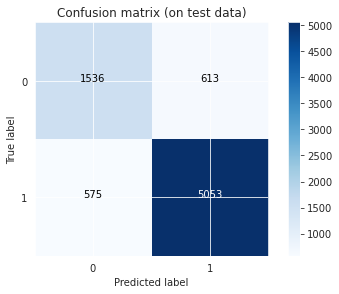

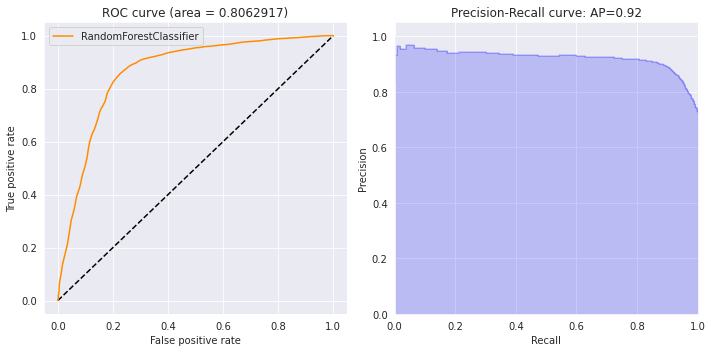

Show top 10 important features:


,feature_importance,ranking
0,,
UTR3length,0.107296,1.0
isoforms,0.056162,2.0
UTR5length,0.047511,3.0
distance,0.027798,4.0
CTDD_prop7_G3_residue0,0.027304,5.0
PseDNC_Xc1_AT,0.027048,6.0
CTDD_prop1_G2_residue0,0.026960,7.0
PseKNC_3_Xc1_ACG,0.026339,8.0
avgExonLength,0.025541,9.0



AUC scores on testing data
RandomForestClassifier auc score: 0.8626649210902213


In [98]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, mean_squared_error
from sklearn.metrics import f1_score, precision_score, recall_score, log_loss, r2_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_auc_score, roc_curve, classification_report
from tabulate import tabulate
import itertools
import numpy as np

folds = 5
param_comb = 5
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state = 10345)
scoring_strings = ['accuracy', 'precision', 'recall', 'f1',
                       'average_precision', 'roc_auc']
trainPerformanceData = pd.DataFrame(columns = ['Algorithm','Scoring Name','CV mean', 'CV std']) 
testPerformanceData = pd.DataFrame(columns = ['Algorithm','Accuracy','AUC','Precision','Recall','F1'])
# timing starts from this point for "start_time" variable
#start_time = timer(None)
for clf_name, clf in nonlr_clf_dict.items():
    for scoring in scoring_strings:
        scores = cross_val_score(clf, X_after_features, y_res, scoring=scoring, cv=skf,verbose=1, n_jobs=2)
        print("---------------------------------------------------------------------") 
        print(clf_name)
        print("---------------------------------------------------------------------") 
        print("Cross Validation scores on training data")
        print ('Scoring Name: CV mean: %.5f CV std: %.5f',scoring,np.mean(np.abs(scores)),np.std(scores))
        print("") 
        # append rows to an empty DataFrame 
        trainPerformanceData = trainPerformanceData.append({'Algorithm' : clf_name, 'Scoring Name' : scoring, 'CV mean' : np.mean(np.abs(scores)),'CV std' : np.std(scores)}, ignore_index = True) 
        clf.fit(X_after_features, y_res)
    y_predicted_test  = clf.predict(X_test_after_features)
    y_probabilities_test = clf.predict_proba(X_test_after_features)
    y_probabilities_success = y_probabilities_test[:, 1]

    from sklearn.metrics import average_precision_score
    average_precision = average_precision_score(y_test, y_probabilities_success)
    print('Average precision-recall score: {0:0.2f}'.format(average_precision))

    false_positive_rate, true_positive_rate, threshold = roc_curve(y_test, y_probabilities_success)

    mse        = mean_squared_error(y_test, y_predicted_test)
    logloss    = log_loss(y_test, y_predicted_test)
    accuracy   = accuracy_score(y_test, y_predicted_test)
    precision  = precision_score(y_test, y_predicted_test, average='binary')
    recall     = recall_score(y_test, y_predicted_test, average='binary')
    F1         = f1_score(y_test, y_predicted_test)
    r2         = r2_score(y_test, y_predicted_test)
    auc        = roc_auc_score(y_test, y_predicted_test)
    cm         = confusion_matrix(y_test, y_predicted_test)
    testPerformanceData = testPerformanceData.append({'Algorithm' : clf_name,'Accuracy' : accuracy,'Average_Precision':average_precision,'F1' : F1 ,'Precision' : precision,'Recall' : recall,'AUC' : auc},ignore_index = True)
    Print_Model_Metrics(clf_name)
    Plot_Confusion_Matrix(clf)
    Plot_ROC_Precision_Recall(clf_name)
#     Plot_Predictor_Importance(clf)
    importance_values = np.absolute(clf.coef_) if clf_name == 'LogisticRegression' else clf.feature_importances_
    importance_fatures_sorted = pd.DataFrame(importance_values.reshape([-1, len(feature_list[0])]), columns=feature_list[0]).mean(axis=0).sort_values(ascending=False).to_frame()
    importance_fatures_sorted.rename(columns={0: 'feature_importance'}, inplace=True)
    importance_fatures_sorted['ranking']= importance_fatures_sorted['feature_importance'].rank(ascending=False)
    importance_fatures_sorted['model'] = clf_name
    print('Show top 10 important features:')
    display(importance_fatures_sorted.drop('model', axis=1).head(50))
    auc = roc_auc_score(y_test, clf.predict_proba(X_test_after_features)[:, 1])
    print("")  
    print("AUC scores on testing data")       
    print(clf_name, 'auc score:', auc)
#timer(start_time

In [100]:
top_25_feature = importance_fatures_sorted.drop('model', axis=1).head(50)
top_25_feature.reset_index(inplace=True)
top_25_feature = top_25_feature.rename(columns = {0:'feature_names'})
top_25_feature.head(25)

,feature_names,feature_importance,ranking
0,UTR3length,0.107296,1.0
1,isoforms,0.056162,2.0
2,UTR5length,0.047511,3.0
3,distance,0.027798,4.0
4,CTDD_prop7_G3_residue0,0.027304,5.0
5,PseDNC_Xc1_AT,0.027048,6.0
6,CTDD_prop1_G2_residue0,0.026960,7.0
7,PseKNC_3_Xc1_ACG,0.026339,8.0
8,avgExonLength,0.025541,9.0
9,TC_SAL,0.025474,10.0


In [101]:
trainPerformanceData

,Algorithm,Scoring Name,CV mean,CV std
0,RandomForestClassifier,accuracy,0.891670,0.002804
1,RandomForestClassifier,precision,0.887831,0.002555
2,RandomForestClassifier,recall,0.896268,0.002002
3,RandomForestClassifier,f1,0.892971,0.001875
4,RandomForestClassifier,average_precision,0.929904,0.003390
5,RandomForestClassifier,roc_auc,0.947604,0.001728


In [102]:
testPerformanceData

,Algorithm,Accuracy,AUC,Precision,Recall,F1,Average_Precision
0,RandomForestClassifier,0.847242,0.806292,0.891811,0.897832,0.894811,0.923032
1,RandomForestClassifier,0.847242,0.806292,0.891811,0.897832,NaN,NaN


In [103]:
trainPerformanceData_pvt=pd.pivot_table(trainPerformanceData,index=["Algorithm"],values=["CV mean"],columns=["Scoring Name"],aggfunc=[np.min])
trainPerformanceData_pvt

amin                                        \
                        CV mean                                         
Scoring Name           accuracy average_precision        f1 precision   
Algorithm                                                               
RandomForestClassifier  0.89167          0.929904  0.892971  0.887831   

                                            
                                            
Scoring Name              recall   roc_auc  
Algorithm                                   
RandomForestClassifier  0.896268  0.947604

In [104]:
top_features = top_25_feature['feature_names'][:25]
list(top_features)
with open('seq_top_25_features.txt', 'w') as out_f:
    for l in list(top_features):
        out_f.write(l + '\n')

In [32]:
top_features = pd.read_csv("seq_top_25_features.txt",header=None)
len(top_features[0])

25

In [33]:
top_features

,0
0,UTR3length
1,isoforms
2,UTR5length
3,distance
4,CTDD_prop7_G3_residue0
5,PseDNC_Xc1_AT
6,CTDD_prop1_G2_residue0
7,PseKNC_3_Xc1_ACG
8,avgExonLength
9,TC_SAL


In [34]:
x_train = X_after_features[top_features[0]]
x_test = X_test_after_features[top_features[0]]
y_train = y_res

In [41]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
models1 = {
    'Logistic Regression' : LogisticRegression(),
    'RandomForestClassifier': RandomForestClassifier(),
    'GradientBoostingClassifier': GradientBoostingClassifier(),
    'ExtraTreesClassifier': ExtraTreesClassifier(),
    'KNeighbors Classifier' : KNeighborsClassifier(),   
    'SVC': SVC()
}
params1 = {
 'Logistic Regression' : {'penalty' : ['l1','l2'], 'C' : np.logspace(0, 4, 10), 'solver' :['liblinear']},
 'RandomForestClassifier': { 'n_estimators': [16, 32] },
 'GradientBoostingClassifier': { 'n_estimators': [16, 32], 'learning_rate': [0.8, 1.0] },
 'ExtraTreesClassifier': { 'n_estimators': [16, 32] },
 'KNeighbors Classifier' : {'n_neighbors' :[1,2,5,6,7,10], 'weights':['uniform', 'distance']}, 
 'SVC': {'kernel': ['linear','rbf'], 'C': [1, 10], 'gamma': [0.001, 0.0001]} 
}

In [42]:
import pandas as pd
import numpy as np
from sklearn.model_selection import RandomizedSearchCV

class EstimatorSelectionHelper:

    def __init__(self, models, params):
        if not set(models.keys()).issubset(set(params.keys())):
            missing_params = list(set(models.keys()) - set(params.keys()))
            raise ValueError("Some estimators are missing parameters: %s" % missing_params)
        self.models = models
        self.params = params
        self.keys = models.keys()
        self.grid_searches = {}

    def fit(self, X, y, cv=5, n_jobs=3, verbose=1, scoring=None, refit=False):
        for key in self.keys:
            print("Running RandomizedSearchCV for %s." % key)
            model = self.models[key]
            params = self.params[key]
            gs = RandomizedSearchCV(estimator= model, param_distributions = params, cv=cv, n_jobs=n_jobs,
                              verbose=verbose, scoring=scoring, random_state = 2020)
            gs.fit(X,y)
            print('=====================================================================')
            print('Best Score: %s' % gs.fit(X,y).best_score_)
            print('Best Hyperparameters: %s' % gs.fit(X,y).best_params_)
            print('=====================================================================')
            self.grid_searches[key] = gs    

    def score_summary(self, sort_by='mean_score'):
        def row(key, scores, params):
            d = {
                 'estimator': key,
                 'min_score': min(scores),
                 'max_score': max(scores),
                 'mean_score': np.mean(scores),
                 'std_score': np.std(scores),
            }
            return pd.Series({**params,**d})

        rows = []
        for k in self.grid_searches:
            print(k)
            params = self.grid_searches[k].cv_results_['params']
            scores = []
            for i in range(self.grid_searches[k].cv):
                key = "split{}_test_score".format(i)
                r = self.grid_searches[k].cv_results_[key]        
                scores.append(r.reshape(len(params),1))

            all_scores = np.hstack(scores)
            for p, s in zip(params,all_scores):
                rows.append((row(k, s, p)))

        df = pd.concat(rows, axis=1).T.sort_values([sort_by], ascending=False)

        columns = ['estimator', 'min_score', 'mean_score', 'max_score', 'std_score']
        columns = columns + [c for c in df.columns if c not in columns]

        return df[columns]

In [ ]:
# Define the scoring 
scoring_strings = ['accuracy', 'precision', 'recall', 'f1', 'average_precision','roc_auc']
scores_all = pd.DataFrame() 
# Create object of the class helper
helper1 = EstimatorSelectionHelper(models1, params1)
flag=True
for scoring in scoring_strings:
    helper1.fit(x_train, y_train, cv=5, scoring=scoring, n_jobs=2)
    df_scores = helper1.score_summary(sort_by='max_score')
    if flag: 
       # Saving each model for each scoring. Plz change with ur path
        df_scores.to_csv(scoring+".csv")
        df_scores['scoring_name']=scoring
        scores_all = df_scores
        print(scoring)
        print(scores_all)
        flag=False
    else:
# Saving each model for each scoring. Plz change with ur path
        df_scores.to_csv(scoring+".csv")
        df_scores['scoring_name']=scoring
        scores_all= scores_all.append(df_scores, ignore_index=True, sort=False)
        print(scoring)
        print(scores_all)
        
# Saving each model for each scoring. Plz change with ur path
scores_all.to_csv("seq_scores_all.csv")

Running RandomizedSearchCV for Logistic Regression.
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Score: 0.7298089737894269
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Hyperparameters: {'solver': 'liblinear', 'penalty': 'l1', 'C': 21.544346900318832}
Running RandomizedSearchCV for RandomForestClassifier.
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Best Score: 0.8773878276321634
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Best Hyperparameters: {'n_estimators': 32}
Running RandomizedSearchCV for GradientBoostingClassifier.
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best Score: 0.8603731674811195
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best Hyperparameters: {'n_estimators': 32, 'learning_rate': 0.8}
Ru

In [ ]:
scores_all.sort_values(by=['mean_score'],ascending=False)

In [ ]:
output_random = pd.pivot_table(scores_all,index=["estimator"],values=["mean_score"],columns=["scoring_name"],
                              aggfunc=[np.max])

In [ ]:
output_random['amax']['mean_score'].sort_values(by='roc_auc',ascending=False)